In [ ]:
import pandas as pd
from google.colab import drive
drive.mount('/content/drive')

import pandas as pd
data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/cleaned_reviews.csv')

Mounted at /content/drive


In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
!pip install seaborn
!pip install numpy==1.26.1


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.2/61.2 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 68.3 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
langchain 0.3.19 requires numpy<2,>=1.26.4; python_version < "3.12", but you have numpy 1.26.1 which is incompatible.


In [ ]:
data.head()

,review_id,user_id,business_id,stars,useful,funny,cool,text,date,clean_text
0,IVS7do_HBzroiCiymNdxDg,fdFgZQQYQJeEAshH4lxSfQ,sGy67CpJctjeCWClWqonjA,3,1,1,0,"OK, the hype about having Hatch chili in your ...",2020-01-27 22:59:06,ok hype hatch chili burger overrate ok like ki...
1,QP2pSzSqpJTMWOCuUuyXkQ,JBLWSXBTKFvJYYiM-FnCOQ,3w7NRntdQ9h0KwDsksIt5Q,5,1,1,1,Pandemic pit stop to have an ice cream.... onl...,2020-04-19 05:33:16,pandemic pit stop ice cream plain Sundae Limit...
2,oK0cGYStgDOusZKz9B1qug,2_9fKnXChUjC5xArfF8BLg,OMnPtRGmbY8qH_wIILfYKA,5,1,0,0,I was lucky enough to go to the soft opening a...,2020-02-29 19:43:44,lucky enough soft opening let tell good beer w...
3,E_ABvFCNVLbfOgRg3Pv1KQ,9MExTQ76GSKhxSWnTS901g,V9XlikTxq0My4gE8LULsjw,5,0,0,0,I've gone to claim Jumpers all over the US and...,2020-03-14 21:47:07,claim Jumpers US never disappoint location dif...
4,Rd222CrrnXkXukR2iWj69g,LPxuausjvDN88uPr-Q4cQA,CA5BOxKRDPGJgdUQ8OUOpw,4,1,0,0,"If you haven't been to Maynard's kitchen, it'...",2020-01-17 20:32:57,Maynard kitchen time hope dinner sure reservat...


In [ ]:
# Create a new column containing the length each headline text
data["clean_text_len"] = data["clean_text"].astype(str).apply(lambda x : len(x.split()))

In [ ]:
data_text = data[['clean_text']];

In [ ]:
print("The longest review has: {} words".format(data.clean_text_len.max()))

The longest review has: 463 words


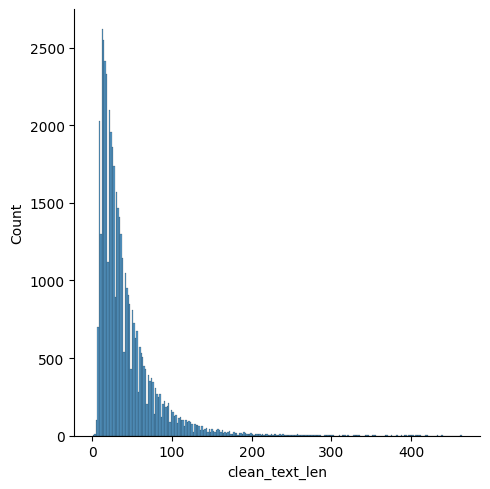

In [ ]:
# Visualize the length distribution
import seaborn as sns
import matplotlib.pyplot as plt
sns.displot(data.clean_text_len, kde=False)

In [ ]:
for idx in data.sample(3).index:
    headline = data.iloc[idx]
    print("Review #{}:".format(idx))
    print("Review date: {}".format(headline.date))
    print("Review_Text: {}\n".format(headline.clean_text))

Review #33631:
Review date: 2021-08-02 19:27:19
Review_Text: fun fact restaurant Thai restaurant USA reward Thai government authentic thai cuisine first time try Thai food obsess green curry beef pad kee mao green curry well spiced savory devour instantly noodle perfectly right amount heat definitely soon often

Review #39310:
Review date: 2021-09-04 02:53:03
Review_Text: love burger bowl zucchini fry take photo starve good

Review #26403:
Review date: 2020-10-21 21:23:05
Review_Text: favorite local spot yummy food Pork Lo mein without vegetable great wish egg drop soup peppered



In [ ]:
!pip install bertopic

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.7/143.7 kB 13.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 101.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 85.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 54.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 94.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
import os
os.environ['TOKENIZERS_PARALLELISM']='true'

In [ ]:
%%time
%matplotlib notebook
from bertopic import BERTopic

# Ensure all values in 'clean_text' are strings
data["clean_text"] = data["clean_text"].astype(str)

model = BERTopic(verbose=True,embedding_model='paraphrase-MiniLM-L3-v2', min_topic_size= 7, calculate_probabilities=True)
topics, probs = model.fit_transform(data.clean_text)

2025-02-27 21:23:00,241 - BERTopic - Embedding - Transforming documents to embeddings.


modules.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/122 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/4.04k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/629 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/69.6M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/314 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling%2Fconfig.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/1505 [00:00<?, ?it/s]

2025-02-27 21:23:35,612 - BERTopic - Embedding - Completed ✓
2025-02-27 21:23:35,613 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-02-27 21:24:55,031 - BERTopic - Dimensionality - Completed ✓
2025-02-27 21:24:55,033 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-02-27 21:30:30,208 - BERTopic - Cluster - Completed ✓
2025-02-27 21:30:30,225 - BERTopic - Representation - Extracting topics from clusters using representation models.
2025-02-27 21:30:32,023 - BERTopic - Representation - Completed ✓


CPU times: user 8min 18s, sys: 11.7 s, total: 8min 30s
Wall time: 8min 25s


In [ ]:
model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,26162,-1_food_order_service_restaurant,"[food, order, service, restaurant, time, wait,...",[service never great clearly take major turn b...
1,0,2980,0_pizza_crust_pepperoni_topping,"[pizza, crust, pepperoni, topping, slice, thin...",[good pizza town order pepperoni pizza amazing...
2,1,943,1_tucson_visit_favorite_place,"[tucson, visit, favorite, place, great, amazin...",[great food great drink highly recommend visit...
3,2,881,2_burger_fry_patty_bun,"[burger, fry, patty, bun, graze, tot, hamburge...",[want pick special restaurant write Yelp revie...
4,3,765,3_sushi_roll_nigiri_sashimi,"[sushi, roll, nigiri, sashimi, tuna, miso, fis...",[Delicious favorite sushi restaurant time spic...
...,...,...,...,...,...
306,305,7,305_said_blacken_screech_willow,"[said, blacken, screech, willow, buddy, madame...",[Tanque verde location time first second time ...
307,306,7,306_tatter_slush_grape_blt,"[tatter, slush, grape, blt, till, min, severel...",[severely disappoint service give location ord...
308,307,7,307_churronut_richard_event_compe,"[churronut, richard, event, compe, espress, sm...",[first time visit Jack Box location late break...
309,308,7,308_mouse_ant_control_baseboard,"[mouse, ant, control, baseboard, cabinet, run,...",[first want say staff nice service good howeve...


In [ ]:
model.get_topic(0)

[('pizza', 0.03396785031239111),
 ('crust', 0.013714428840599802),
 ('pepperoni', 0.007738710502351791),
 ('topping', 0.006504068033898372),
 ('slice', 0.0064557518173558965),
 ('thin', 0.005389235829972813),
 ('cheese', 0.004829755295392364),
 ('wing', 0.0045815752509465015),
 ('pie', 0.004548215695484154),
 ('salad', 0.004424979756739343)]

In [ ]:
model.get_document_info(data.clean_text)

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
0,ok hype hatch chili burger overrate ok like ki...,153,153_dime_mind_category_tier,"[dime, mind, category, tier, element, whim, wo...",[free birthday breakfast wife really enjoy swe...,dime - mind - category - tier - element - whim...,0.095894,False
1,pandemic pit stop ice cream plain Sundae Limit...,7,7_mask_wear_employee_require,"[mask, wear, employee, require, nose, safety, ...",[everyone wear mask eat fish fry excellent ser...,mask - wear - employee - require - nose - safe...,0.181288,False
2,lucky enough soft opening let tell good beer w...,37,37_wine_selection_bruschetta_board,"[wine, selection, bruschetta, board, glass, li...",[menu update overall delicious food great drin...,wine - selection - bruschetta - board - glass ...,0.020422,False
3,claim Jumpers US never disappoint location dif...,-1,-1_food_order_service_restaurant,"[food, order, service, restaurant, time, wait,...",[service never great clearly take major turn b...,food - order - service - restaurant - time - w...,0.128712,False
4,Maynard kitchen time hope dinner sure reservat...,-1,-1_food_order_service_restaurant,"[food, order, service, restaurant, time, wait,...",[service never great clearly take major turn b...,food - order - service - restaurant - time - w...,0.366251,False
...,...,...,...,...,...,...,...,...
48142,wow lot star review place normally scare cowor...,-1,-1_food_order_service_restaurant,"[food, order, service, restaurant, time, wait,...",[service never great clearly take major turn b...,food - order - service - restaurant - time - w...,0.337384,False
48143,fresh delicious food serve fast ask Margaritas...,-1,-1_food_order_service_restaurant,"[food, order, service, restaurant, time, wait,...",[service never great clearly take major turn b...,food - order - service - restaurant - time - w...,0.006810,False
48144,could leave star understand busy location may ...,-1,-1_food_order_service_restaurant,"[food, order, service, restaurant, time, wait,...",[service never great clearly take major turn b...,food - order - service - restaurant - time - w...,0.376134,False
48145,bosnian food location HIDDEN GEM guarantee dri...,-1,-1_food_order_service_restaurant,"[food, order, service, restaurant, time, wait,...",[service never great clearly take major turn b...,food - order - service - restaurant - time - w...,0.859850,False


In [ ]:
topics[:5]

[153, 7, 37, -1, -1]

In [ ]:
probs[:5]

array([[0.00076298, 0.0008517 , 0.00103803, ..., 0.00080881, 0.00068201,
        0.00063401],
       [0.00157392, 0.0018048 , 0.0020849 , ..., 0.00310286, 0.00310913,
        0.00468975],
       [0.00078175, 0.00193772, 0.00095537, ..., 0.00112559, 0.00168845,
        0.00108489],
       [0.00115349, 0.03247472, 0.00178252, ..., 0.00161477, 0.00227776,
        0.00150468],
       [0.00113687, 0.00133263, 0.00162161, ..., 0.00331931, 0.00162352,
        0.00293626]])

In [ ]:
model.reduce_topics(data.clean_text, nr_topics=20)

2025-02-27 21:31:04,149 - BERTopic - Topic reduction - Reducing number of topics
2025-02-27 21:31:05,763 - BERTopic - Topic reduction - Reduced number of topics from 311 to 20


In [ ]:
topics = model.topics_

In [ ]:
topics[:10]

[0, 1, 0, -1, -1, 9, 0, 0, -1, -1]

In [ ]:
model.probabilities_[:10]

array([[3.63475011e-01, 1.54088803e-03, 2.89001927e-03, 2.00921314e-03,
        1.19509376e-03, 6.10412290e-04, 2.47674164e-04, 1.91007228e-03,
        7.49538751e-04, 4.64711087e-04, 1.18549427e-03, 1.33873068e-03,
        6.07675819e-04, 5.72899931e-04, 6.33324865e-04, 4.81417957e-04,
        9.38341899e-04, 8.95660064e-04, 1.75479714e-03],
       [6.90641790e-01, 2.09496912e-01, 2.45968652e-02, 8.27762703e-03,
        9.35697938e-03, 3.41134162e-03, 7.02272340e-04, 1.20088350e-02,
        2.51271787e-03, 5.13761956e-03, 7.07213977e-03, 6.89054731e-03,
        1.85725414e-03, 5.88525255e-03, 3.42677188e-03, 3.99915823e-03,
        1.49554640e-03, 1.65024844e-03, 1.58012089e-03],
       [4.36245074e-01, 3.24110139e-03, 6.20979922e-03, 5.16135046e-03,
        1.90380244e-03, 8.56794621e-04, 2.91503918e-04, 3.03189369e-03,
        8.61187737e-04, 1.19360186e-03, 5.42201607e-03, 8.77296673e-03,
        1.04493276e-03, 1.06017977e-03, 2.54443294e-03, 1.10731020e-03,
        1.09744583e-03

In [ ]:
model.get_document_info(data.clean_text)

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
0,ok hype hatch chili burger overrate ok like ki...,0,0_good_pizza_food_place,"[good, pizza, food, place, order, great, time,...",[amazed review place low perhaps improve drama...,good - pizza - food - place - order - great - ...,0.363475,False
1,pandemic pit stop ice cream plain Sundae Limit...,1,1_mask_wear_employee_customer,"[mask, wear, employee, customer, require, glov...",[Sign door state patron wear mask Staff wear m...,mask - wear - employee - customer - require - ...,0.690642,False
2,lucky enough soft opening let tell good beer w...,0,0_good_pizza_food_place,"[good, pizza, food, place, order, great, time,...",[amazed review place low perhaps improve drama...,good - pizza - food - place - order - great - ...,0.436245,False
3,claim Jumpers US never disappoint location dif...,-1,-1_food_order_good_place,"[food, order, good, place, time, service, grea...",[husband order tonight first time long time be...,food - order - good - place - time - service -...,0.128712,False
4,Maynard kitchen time hope dinner sure reservat...,-1,-1_food_order_good_place,"[food, order, good, place, time, service, grea...",[husband order tonight first time long time be...,food - order - good - place - time - service -...,0.366251,False
...,...,...,...,...,...,...,...,...
48142,wow lot star review place normally scare cowor...,-1,-1_food_order_good_place,"[food, order, good, place, time, service, grea...",[husband order tonight first time long time be...,food - order - good - place - time - service -...,0.337384,False
48143,fresh delicious food serve fast ask Margaritas...,-1,-1_food_order_good_place,"[food, order, good, place, time, service, grea...",[husband order tonight first time long time be...,food - order - good - place - time - service -...,0.006810,False
48144,could leave star understand busy location may ...,-1,-1_food_order_good_place,"[food, order, good, place, time, service, grea...",[husband order tonight first time long time be...,food - order - good - place - time - service -...,0.376134,False
48145,bosnian food location HIDDEN GEM guarantee dri...,-1,-1_food_order_good_place,"[food, order, good, place, time, service, grea...",[husband order tonight first time long time be...,food - order - good - place - time - service -...,0.859850,False


In [ ]:
freq = model.get_topic_info()
print("Number of topics: {}".format( len(freq)))
freq.head()

Number of topics: 20


,Topic,Count,Name,Representation,Representative_Docs
0,-1,26162,-1_food_order_good_place,"[food, order, good, place, time, service, grea...",[husband order tonight first time long time be...
1,0,20581,0_good_pizza_food_place,"[good, pizza, food, place, order, great, time,...",[amazed review place low perhaps improve drama...
2,1,522,1_mask_wear_employee_customer,"[mask, wear, employee, customer, require, glov...",[Sign door state patron wear mask Staff wear m...
3,2,381,2_room_stay_hotel_pool,"[room, stay, hotel, pool, bathroom, clean, res...",[check night stay ask front desk could extend ...
4,3,128,3_eegee_movie_popcorn_roadhouse,"[eegee, movie, popcorn, roadhouse, theater, dr...",[Boyfriend use love guilty pleasure always buy...


In [ ]:
a_topic = freq.iloc[1]["Topic"] # Select the 1st topic
model.get_topic(a_topic) # Show the words and their c-TF-IDF scores

[('good', 0.0250831190558566),
 ('pizza', 0.023012339230880068),
 ('food', 0.02153140399232694),
 ('place', 0.020308105467551213),
 ('order', 0.020231297881825046),
 ('great', 0.019479968862987432),
 ('time', 0.016882277403816676),
 ('service', 0.015670656036379647),
 ('try', 0.015339031711324115),
 ('like', 0.01483614009346127)]

In [ ]:
import plotly.io as pio

# Set the default renderer for Jupyter
pio.renderers.default = 'colab'  # Or try 'plotly_mimetype', 'browser', or 'colab' if needed

In [ ]:
# Visualize the barchart
fig = model.visualize_barchart(top_n_topics=10, n_words=10, height=500)
# Display the figure explicitly
fig.show()

#model.visualize_barchart(top_n_topics=10,n_words=10,height = 500)

In [ ]:
# Visualize the barchart
fig = model.visualize_topics(top_n_topics=10)

# Display the figure explicitly
fig.show()

In [ ]:
# Visualize the barchart
fig = model.visualize_hierarchy(top_n_topics=30)

# Display the figure explicitly
fig.show()

In [ ]:
# Visualize the barchart
fig = model.visualize_documents(data.clean_text)

# Display the figure explicitly
fig.show()


In [ ]:
# Visualize the barchart
hierarchical_topics = model.hierarchical_topics(data.clean_text)
fig=model.visualize_hierarchical_documents(data.clean_text, hierarchical_topics)

# Display the figure explicitly
fig.show()

100%|██████████| 18/18 [00:00<00:00, 43.27it/s]


In [ ]:
# Select most 3 similar topics
similar_topics, similarity = model.find_topics("pizza", top_n = 3)

In [ ]:
similar_topics

[0, -1, 12]

In [ ]:
most_similar = similar_topics[0]
print("The Most Similar Topic Info: \n{}".format(model.get_topic(most_similar)))
print("Similarity Score: {}".format(similarity[0]))

The Most Similar Topic Info: 
[('good', 0.0250831190558566), ('pizza', 0.023012339230880068), ('food', 0.02153140399232694), ('place', 0.020308105467551213), ('order', 0.020231297881825046), ('great', 0.019479968862987432), ('time', 0.016882277403816676), ('service', 0.015670656036379647), ('try', 0.015339031711324115), ('like', 0.01483614009346127)]
Similarity Score: 0.5087079535905492


### Zeroshot Topic Modelling

In [ ]:
from bertopic.representation import KeyBERTInspired
zeroshot_topic_list = ["pizza", "time", "service"]

# We fit our model using the zero-shot topics
# and we define a minimum similarity. For each document,
# if the similarity does not exceed that value, it will be used
# for clustering instead.
topic_model = BERTopic(
    embedding_model="thenlper/gte-small",
    min_topic_size=5,
    zeroshot_topic_list=zeroshot_topic_list,
    zeroshot_min_similarity=.75,
    representation_model=KeyBERTInspired()
)
topics, _ = topic_model.fit_transform(data.clean_text)

In [ ]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,26,-1_racist_americans_owner_woman,"[racist, americans, owner, woman, people, arre...",[racist hotel black woman arrest bar nothing w...
1,0,30489,pizza,"[restaurant, food, eat, tasty, delicious, tast...",[special Valentine Day dinner husband top actu...
2,1,1663,time,"[food, restaurant, waitress, wait, eat, dinner...",[overall food taste good seem like wait time l...
3,2,15969,service,"[restaurant, food, waitress, eat, service, enj...",[food great service experience terrible place ...


In [ ]:
import pandas as pd
from google.colab import files

# Add the BERTopic topic assignments to the original reviews dataframe
data['topic'] = topics  # 'topics' is the result from BERTopic

# Save the dataset with topic assignments
data.to_csv("bertopic_reviews.csv", index=False)

# Download the CSV file
files.download("bertopic_reviews.csv")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>